In [49]:
import tensorflow as tf
import cv2
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, Dropout, MaxPooling2D, Dense, Flatten
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
from tensorflow.keras.optimizers import SGD
import matplotlib.pyplot as plt
import os
import numpy as np
from sklearn.metrics import confusion_matrix

In [50]:
height = 1080
width = 1920
channels = 3
scale_factor = 0.2
scaled_height = int(height * scale_factor)
scaled_width = int(width * scale_factor)
input_shape = (scaled_height, scaled_width, channels)
batch_size = 16
epochs = 50
training_dir = 'data/training/'
validation_dir = 'data/validation/'

def image_count(directory):
    dir_abs_path = os.path.join(os.getcwd(), directory)
    count = 0
    for name in os.listdir(dir_abs_path):
        if os.path.isfile(os.path.join(dir_abs_path, name)):
            count += 1
    return count

num_training_samples = image_count(training_dir + 'train/') + image_count(training_dir + 'no_train/')
num_validation_samples = image_count(validation_dir + 'train/') + image_count(validation_dir + 'no_train/')

print("Scaled height: {}".format(scaled_height))
print("Scaled width: {}".format(scaled_width))
print("Input shape: {}".format(input_shape))
print("Batch size: {}".format(batch_size))
print("# epochs: {}".format(epochs))
print("# training samples: {}".format(num_training_samples))
print("# validation samples: {}".format(num_validation_samples))

Scaled height: 216
Scaled width: 384
Input shape: (216, 384, 3)
Batch size: 16
# epochs: 50
# training samples: 3013
# validation samples: 749


In [51]:
def create_model():
    model = Sequential()
    model.add(Conv2D(32, (3, 3), input_shape=input_shape, activation='relu'))
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Dropout(0.2))

    model.add(Conv2D(32, (3, 3), activation='relu'))
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Dropout(0.2))

    model.add(Conv2D(64, (3, 3), activation='relu'))
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Dropout(0.2))

    model.add(Flatten())
    model.add(Dense(64, activation='relu'))
    model.add(Dropout(0.5))
    model.add(Dense(1, activation='sigmoid'))

    model.compile(loss='binary_crossentropy',
                  optimizer=SGD(lr=1e-4, momentum=0.9),
                  metrics=['accuracy'])
    
    return model

# Instantiate the model
model = create_model()
print(model.summary())

Model: "sequential_7"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_21 (Conv2D)           (None, 214, 382, 32)      896       
_________________________________________________________________
max_pooling2d_21 (MaxPooling (None, 107, 191, 32)      0         
_________________________________________________________________
dropout_25 (Dropout)         (None, 107, 191, 32)      0         
_________________________________________________________________
conv2d_22 (Conv2D)           (None, 105, 189, 32)      9248      
_________________________________________________________________
max_pooling2d_22 (MaxPooling (None, 52, 94, 32)        0         
_________________________________________________________________
dropout_26 (Dropout)         (None, 52, 94, 32)        0         
_________________________________________________________________
conv2d_23 (Conv2D)           (None, 50, 92, 64)       

In [52]:
# Set up training and validation data
training_datagen = ImageDataGenerator(rescale = 1./255
#                                       rotation_range = 30,
#                                       width_shift_range = 0.3,
#                                       height_shift_range = 0.3,
#                                       horizontal_flip = True,
#                                       fill_mode = 'nearest'
                                     )

validation_datagen = ImageDataGenerator(rescale = 1./255)

training_generator = training_datagen.flow_from_directory(
        'data/training/',
        target_size=(scaled_height, scaled_width),
        batch_size=batch_size,
        class_mode='binary',
        shuffle=True)

validation_generator = validation_datagen.flow_from_directory(
        'data/validation/',
        target_size=(scaled_height, scaled_width),
        batch_size=batch_size,
        class_mode='binary',
        shuffle=False)

Found 3013 images belonging to 2 classes.
Found 749 images belonging to 2 classes.


In [53]:
callbacks = [EarlyStopping(monitor = 'val_loss', patience = 3),
             ModelCheckpoint(filepath = 'train_detection_cnn.h5', monitor = 'val_loss', save_best_only = True)]

In [54]:
# Train the model over several epochs and save the results from the best epoch
history = model.fit_generator(
    training_generator,
    steps_per_epoch = num_training_samples // batch_size,
    epochs = epochs,
    callbacks = callbacks,
    validation_data = validation_generator,
    validation_steps = num_validation_samples // batch_size)

Epoch 1/50
188/188 [==============================] - 101s 540ms/step - loss: 0.6212 - accuracy: 0.6707 - val_loss: 0.5881 - val_accuracy: 0.7690
Epoch 2/50
188/188 [==============================] - 104s 554ms/step - loss: 0.5583 - accuracy: 0.7047 - val_loss: 0.5214 - val_accuracy: 0.8234
Epoch 3/50
188/188 [==============================] - 108s 577ms/step - loss: 0.4692 - accuracy: 0.7858 - val_loss: 0.4062 - val_accuracy: 0.9538
Epoch 4/50
188/188 [==============================] - 108s 574ms/step - loss: 0.3584 - accuracy: 0.8665 - val_loss: 0.2849 - val_accuracy: 0.9579
Epoch 5/50
188/188 [==============================] - 114s 604ms/step - loss: 0.2783 - accuracy: 0.8946 - val_loss: 0.2064 - val_accuracy: 0.9606
Epoch 6/50
188/188 [==============================] - 125s 665ms/step - loss: 0.2344 - accuracy: 0.9092 - val_loss: 0.1614 - val_accuracy: 0.9660
Epoch 7/50
188/188 [==============================] - 123s 656ms/step - loss: 0.2119 - accuracy: 0.9139 - val_loss: 0.1612 -

In [55]:
# Load the best results
model.load_weights('train_detection_cnn.h5')

ValueError: x and y must have same first dimension, but have shapes (50,) and (15,)

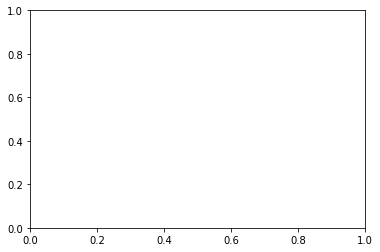

In [56]:
# Plot loss curves
# TODO: Currently there are clear signs of overfitting (with 25 epochs). Probably need more training data
# and maybe an additional dropout layer(s).
epochs_array = np.arange(epochs)
loss_values = history.history['loss']
val_loss_values = history.history['val_loss']
line1 = plt.plot(epochs_array, val_loss_values, label='Validation Loss')
line2 = plt.plot(epochs_array, loss_values, label='Training Loss')
plt.setp(line1, linewidth = 2.0, marker = '+', markersize = 10.0)
plt.setp(line2, linewidth = 2.0, marker = '4', markersize = 10.0)
plt.xlabel('Epochs') 
plt.ylabel('Loss')
plt.grid(True)
plt.legend()
plt.show()

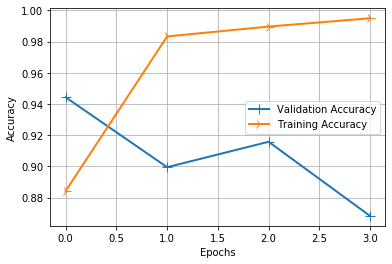

In [9]:
# Plot accuracy curves
acc_values = history.history['accuracy']
val_acc_values = history.history['val_accuracy']
line1 = plt.plot(epochs_array, val_acc_values, label='Validation Accuracy')
line2 = plt.plot(epochs_array, acc_values, label='Training Accuracy')
plt.setp(line1, linewidth = 2.0, marker = '+', markersize = 10.0)
plt.setp(line2, linewidth = 2.0, marker = '4', markersize = 10.0)
plt.xlabel('Epochs') 
plt.ylabel('Accuracy')
plt.grid(True)
plt.legend()
plt.show()

In [10]:
y_true = validation_generator.classes
y_pred = model.predict_generator(validation_generator).flatten()
class_idx_dict = validation_generator.class_indices
print('Class index for \'no_train\' is {}.'.format(class_idx_dict['no_train']))
print('Class index for \'train\' is {}.'.format(class_idx_dict['train']))

Class index for 'no_train' is 0.
Class index for 'train' is 1.


In [18]:
# TODO: eventually don't use path, use preloaded image
LAYER_NAME = 'conv2d_3'
def create_grad_cam_heatmap(img_path):
    img = tf.keras.preprocessing.image.load_img(img_path, target_size=(scaled_height, scaled_width))
    img = tf.keras.preprocessing.image.img_to_array(img)
    grad_model = tf.keras.models.Model([model.inputs], [model.get_layer(LAYER_NAME).output, model.output])
    grad_model.layers[-1].activation = None
    
    with tf.GradientTape() as tape:
        conv_outputs, predictions = grad_model(np.array([img]))
        score = predictions[:, 0]

    output = conv_outputs[0]
    grads = tape.gradient(score, conv_outputs)[0]

    gate_f = tf.cast(output > 0, 'float32')
    gate_r = tf.cast(grads > 0, 'float32')
    guided_grads = tf.cast(output > 0, 'float32') * tf.cast(grads > 0, 'float32') * grads

    weights = tf.reduce_mean(guided_grads, axis=(0, 1))

    cam = np.ones(output.shape[0: 2], dtype = np.float32)

    for i, w in enumerate(weights):
        cam += w * output[:, :, i]

    cam = cv2.resize(cam.numpy(), (scaled_width, scaled_height))
    cam = np.maximum(cam, 0)
    heatmap = (cam - cam.min()) / (cam.max() - cam.min())

    cam = cv2.applyColorMap(np.uint8(255*heatmap), cv2.COLORMAP_JET)

    output_image_bgr = cv2.addWeighted(cv2.cvtColor(img.astype('uint8'), cv2.COLOR_RGB2BGR), 0.5, cam, 1, 0)
    output_image_rgb = output_image_bgr[:,:,::-1]
    
    return output_image_rgb

Model said no_train/variety000279.jpg contained a train (0.5962681174278259), but it didn't:


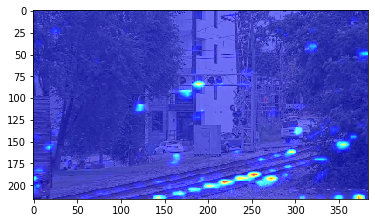

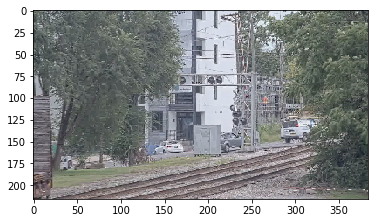

Model said no_train/variety000280.jpg contained a train (0.6591141223907471), but it didn't:


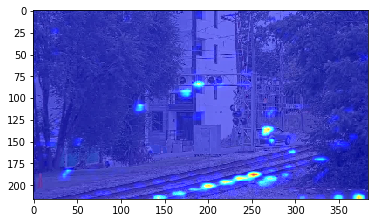

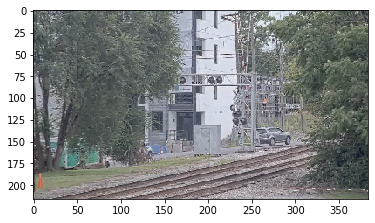

Model said no_train/variety000281.jpg contained a train (0.8364530205726624), but it didn't:


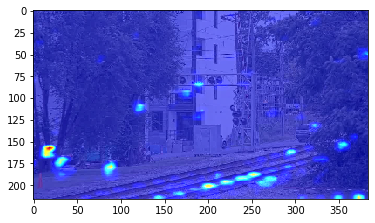

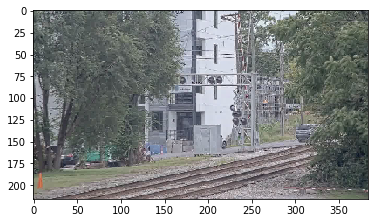

Model said no_train/variety000282.jpg contained a train (0.8197429180145264), but it didn't:


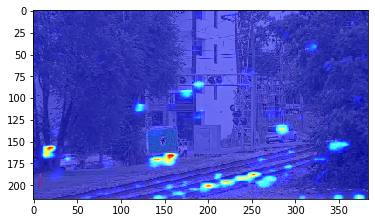

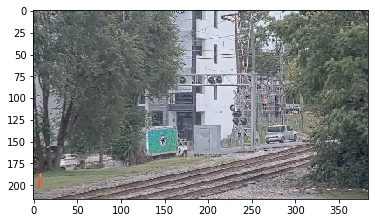

Model said no_train/variety000283.jpg contained a train (0.8999572992324829), but it didn't:


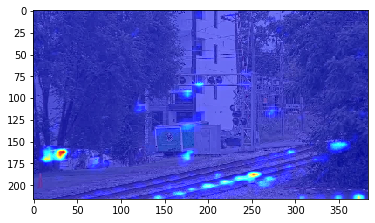

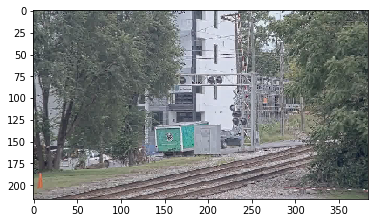

Model said no_train/variety000284.jpg contained a train (0.8600049614906311), but it didn't:


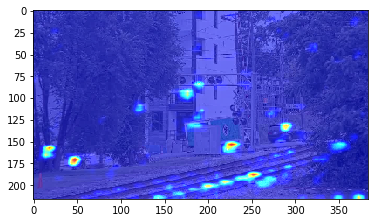

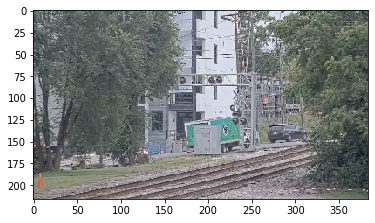

Model said no_train/variety000285.jpg contained a train (0.7897104620933533), but it didn't:


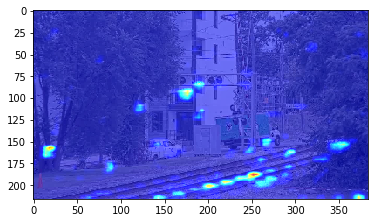

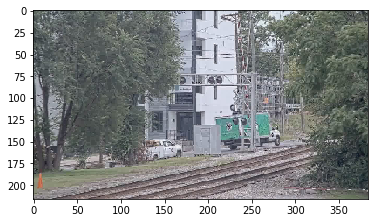

Model said no_train/variety000286.jpg contained a train (0.6662805676460266), but it didn't:


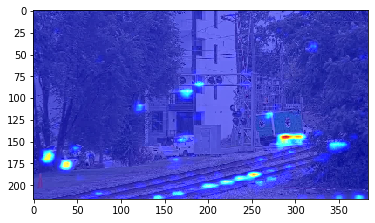

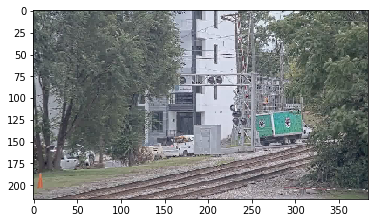

Model said no_train/variety000287.jpg contained a train (0.8624101877212524), but it didn't:


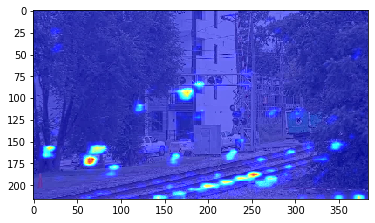

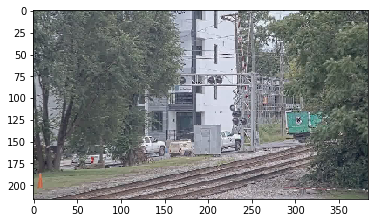

Model said no_train/variety000288.jpg contained a train (0.7394401431083679), but it didn't:


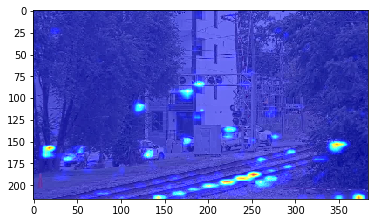

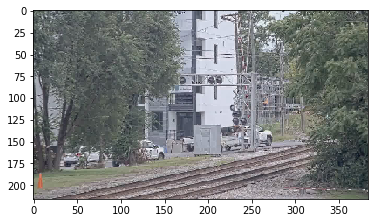

Model said no_train/variety000289.jpg contained a train (0.730948805809021), but it didn't:


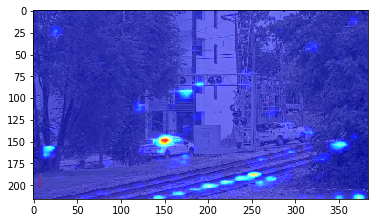

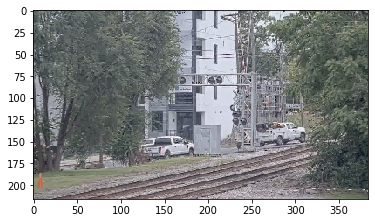

Model said no_train/variety000290.jpg contained a train (0.7749736309051514), but it didn't:


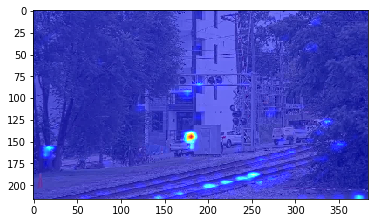

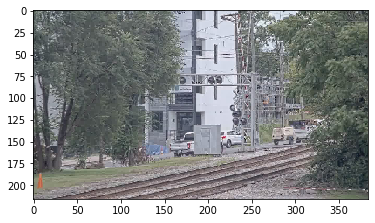

Model said no_train/variety000291.jpg contained a train (0.8071117401123047), but it didn't:


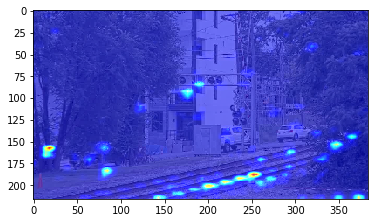

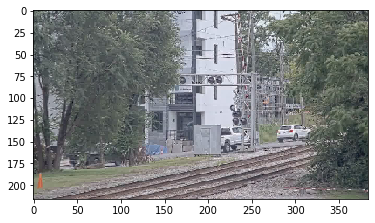

Model said no_train/variety000292.jpg contained a train (0.7977330684661865), but it didn't:


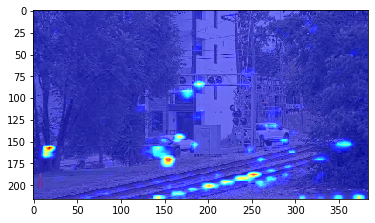

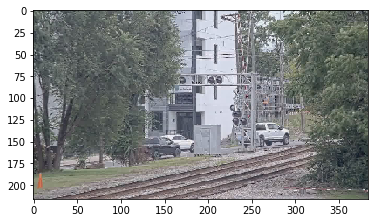

Model said no_train/variety000293.jpg contained a train (0.7483890056610107), but it didn't:


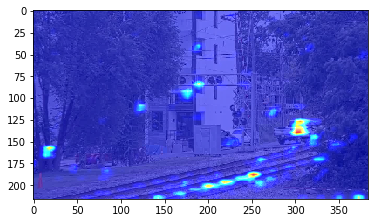

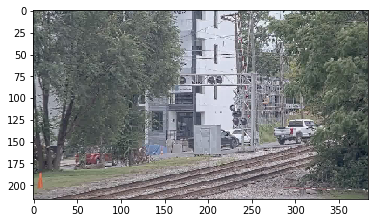

Model said no_train/variety000294.jpg contained a train (0.6923219561576843), but it didn't:


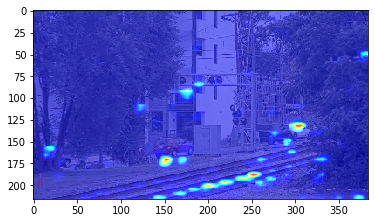

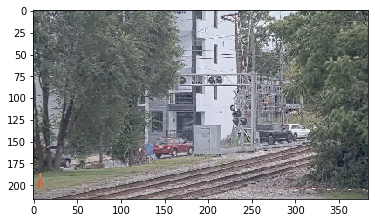

Model said no_train/variety000295.jpg contained a train (0.7778854370117188), but it didn't:


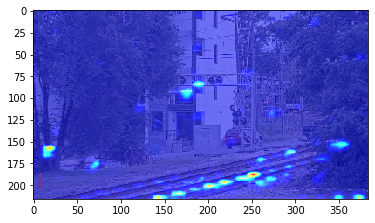

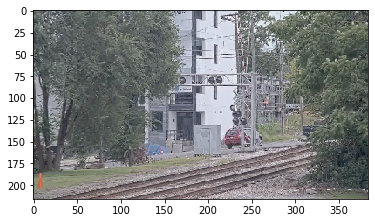

Model said no_train/variety000296.jpg contained a train (0.8081809282302856), but it didn't:


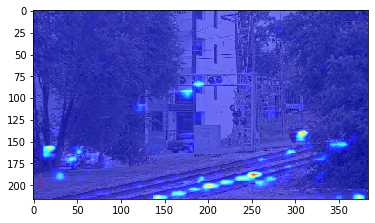

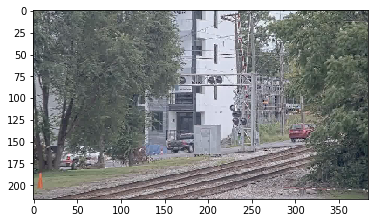

Model said no_train/variety000297.jpg contained a train (0.7458701133728027), but it didn't:


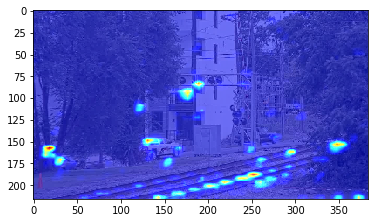

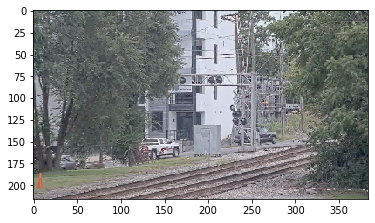

Model said no_train/variety000298.jpg contained a train (0.7738898992538452), but it didn't:


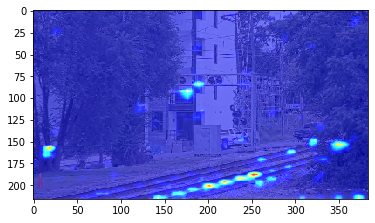

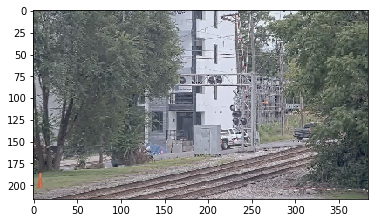

Model said no_train/variety000299.jpg contained a train (0.6032348871231079), but it didn't:


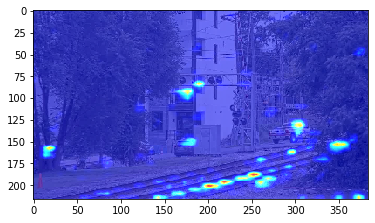

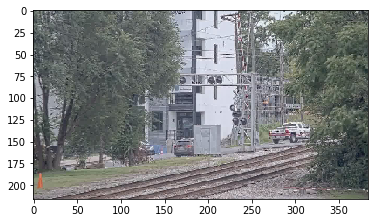

Model said no_train/variety000300.jpg contained a train (0.7776181697845459), but it didn't:


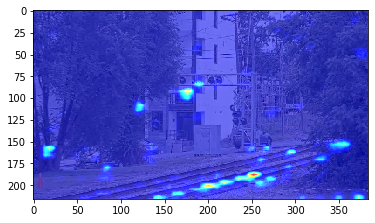

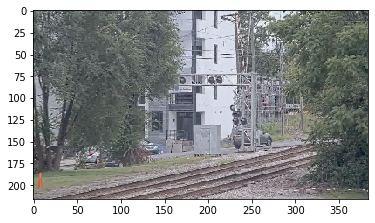

Model said no_train/variety000301.jpg contained a train (0.6942557096481323), but it didn't:


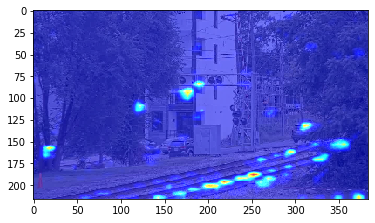

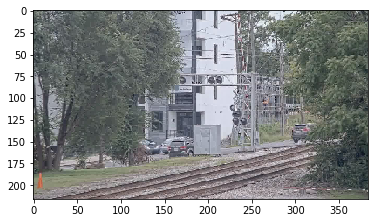

Model said no_train/variety000302.jpg contained a train (0.7857156991958618), but it didn't:


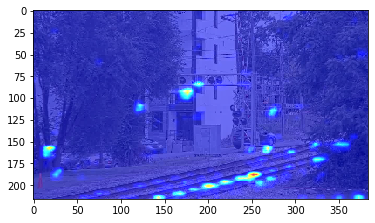

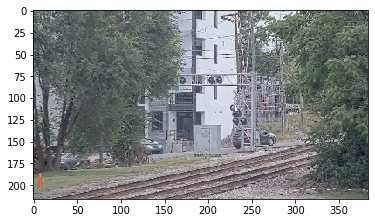

Model said no_train/variety000303.jpg contained a train (0.7856681942939758), but it didn't:


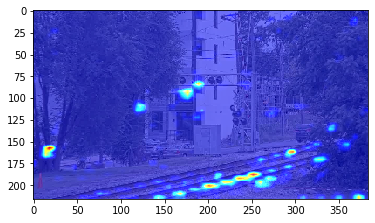

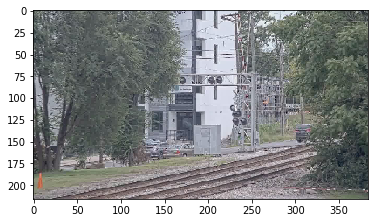

Model said no_train/variety000304.jpg contained a train (0.7658840417861938), but it didn't:


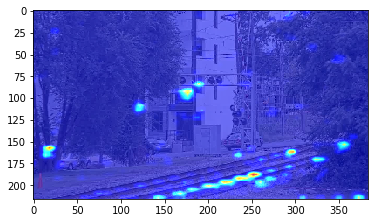

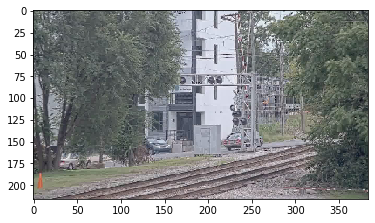

Model said no_train/variety000305.jpg contained a train (0.7899757623672485), but it didn't:


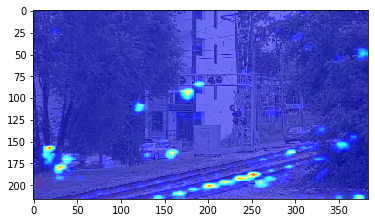

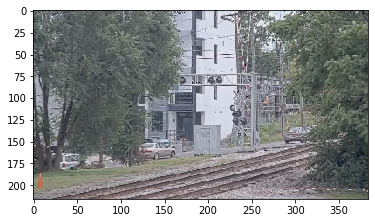

Model said no_train/variety000306.jpg contained a train (0.8358421325683594), but it didn't:


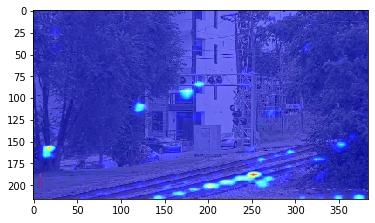

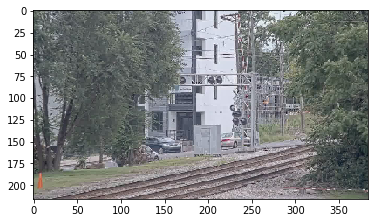

Model said no_train/variety000307.jpg contained a train (0.7789570093154907), but it didn't:


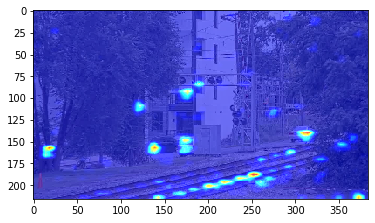

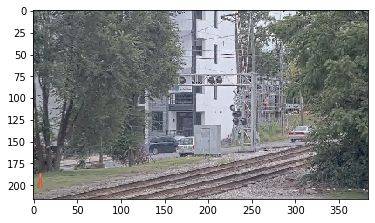

Model said no_train/variety000308.jpg contained a train (0.7842334508895874), but it didn't:


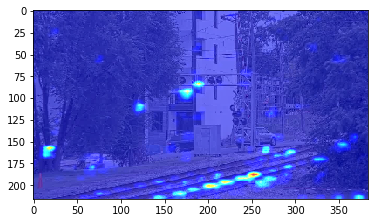

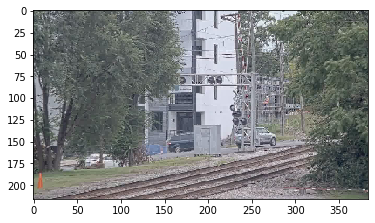

Model said no_train/variety000309.jpg contained a train (0.8116551637649536), but it didn't:


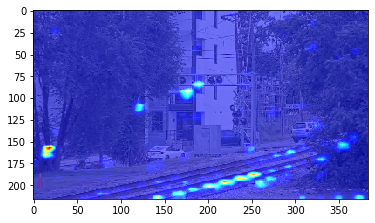

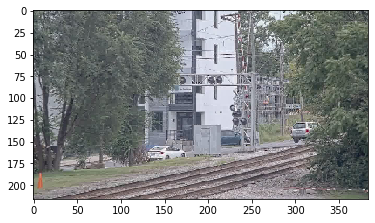

Model said no_train/variety000310.jpg contained a train (0.7836401462554932), but it didn't:


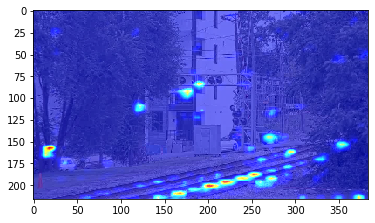

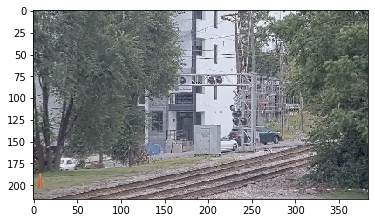

Model said no_train/variety000311.jpg contained a train (0.7762095928192139), but it didn't:


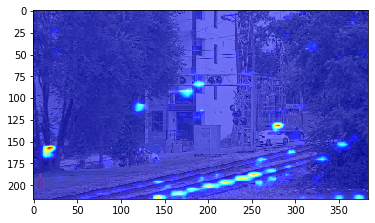

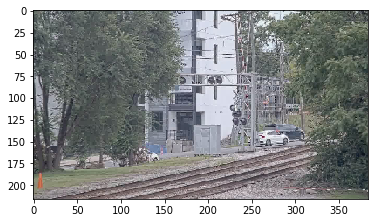

Model said no_train/variety000312.jpg contained a train (0.7843954563140869), but it didn't:


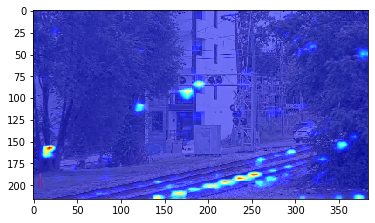

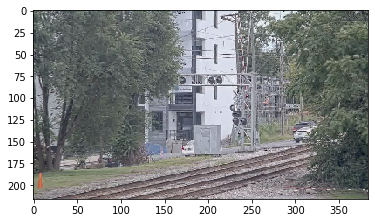

Model said no_train/variety000313.jpg contained a train (0.8059262037277222), but it didn't:


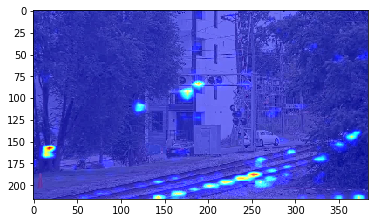

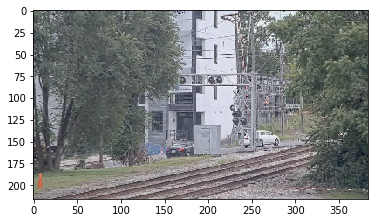

Model said no_train/variety000314.jpg contained a train (0.8041610717773438), but it didn't:


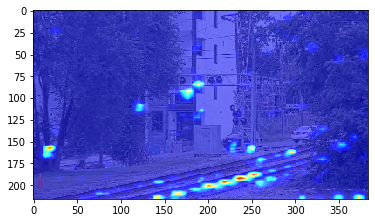

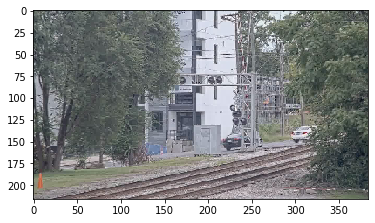

Model said no_train/variety000315.jpg contained a train (0.8220839500427246), but it didn't:


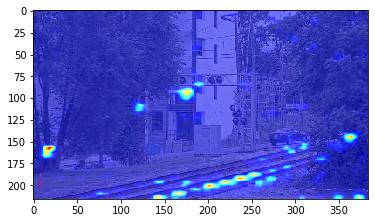

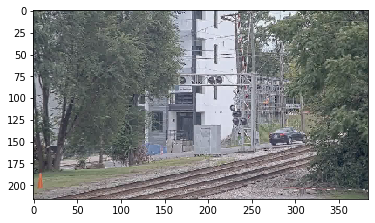

Model said no_train/variety000316.jpg contained a train (0.8428939580917358), but it didn't:


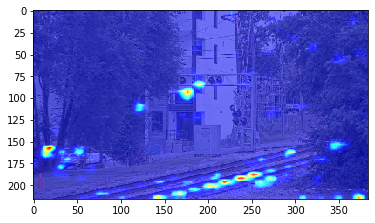

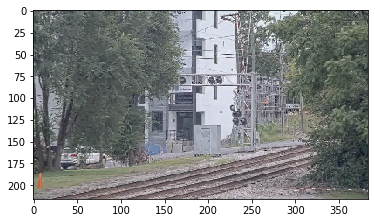

Model said no_train/variety000317.jpg contained a train (0.745335042476654), but it didn't:


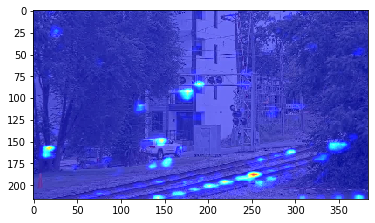

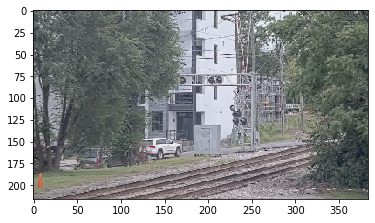

Model said no_train/variety000318.jpg contained a train (0.8452697396278381), but it didn't:


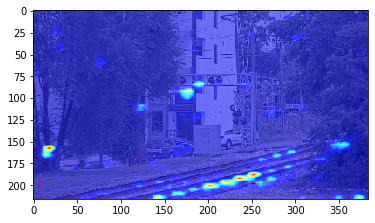

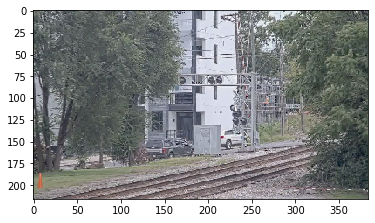

Model said no_train/variety000319.jpg contained a train (0.7854486703872681), but it didn't:


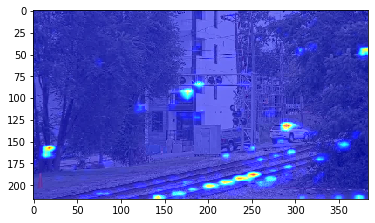

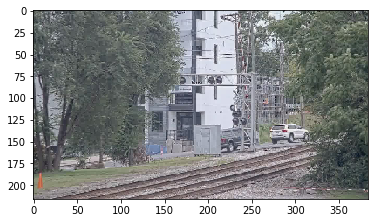

Model said no_train/variety000320.jpg contained a train (0.767960786819458), but it didn't:


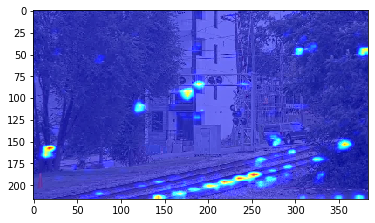

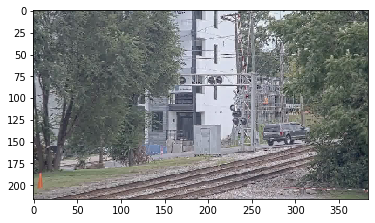

Model said no_train/variety000321.jpg contained a train (0.7874386310577393), but it didn't:


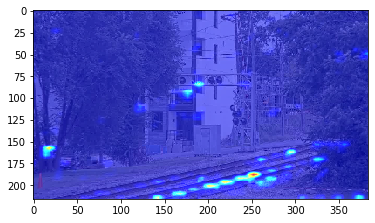

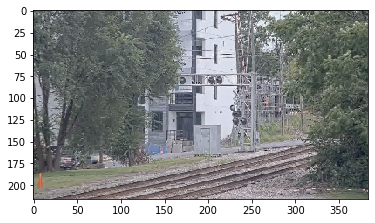

Model said no_train/variety000322.jpg contained a train (0.7752999067306519), but it didn't:


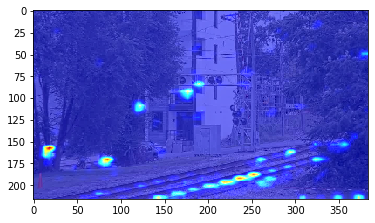

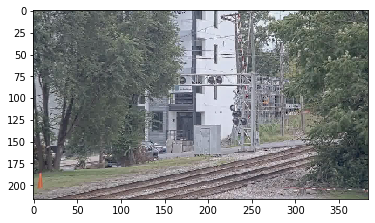

Model said no_train/variety000323.jpg contained a train (0.8000776767730713), but it didn't:


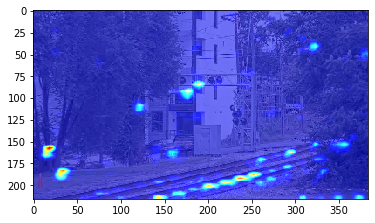

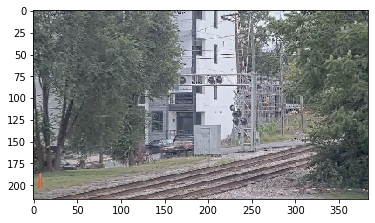

Model said train/mnp-20191116_021630_619C-0008.jpg did not contain a train (0.07107633352279663), but it did:


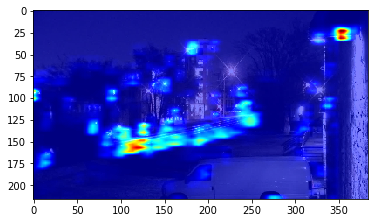

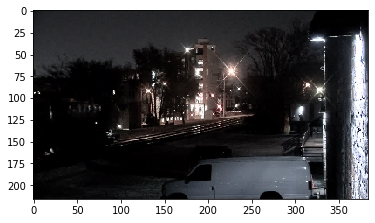

Model said train/variety000028.jpg did not contain a train (0.4824553430080414), but it did:


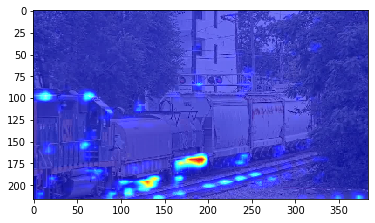

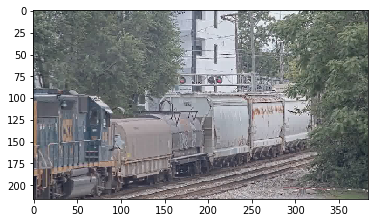

Model said train/variety000030.jpg did not contain a train (0.2523525655269623), but it did:


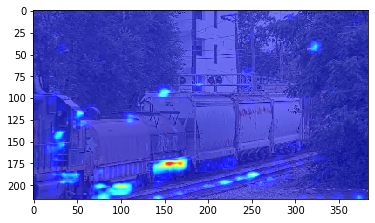

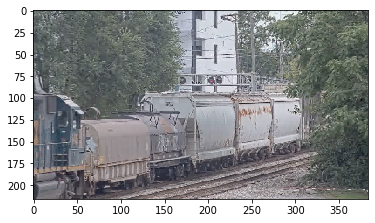

Model said train/variety000051.jpg did not contain a train (0.46061450242996216), but it did:


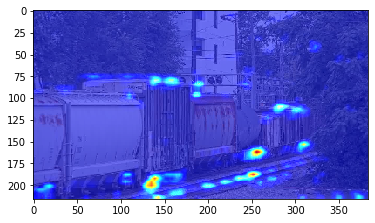

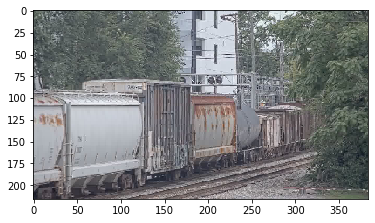

Model said train/variety000053.jpg did not contain a train (0.46355652809143066), but it did:


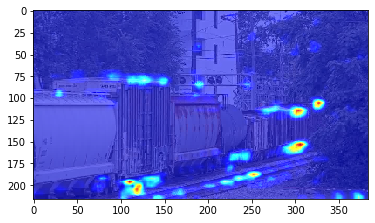

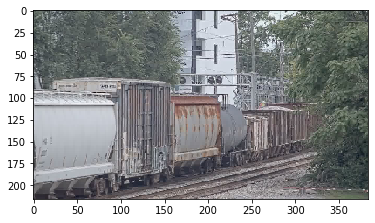

Model said train/variety000057.jpg did not contain a train (0.38687363266944885), but it did:


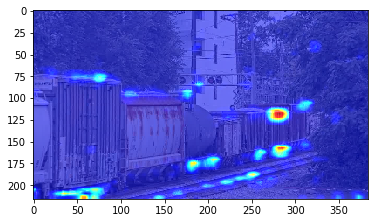

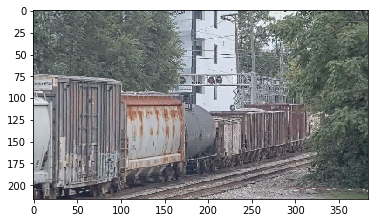

Model said train/variety000058.jpg did not contain a train (0.28354209661483765), but it did:


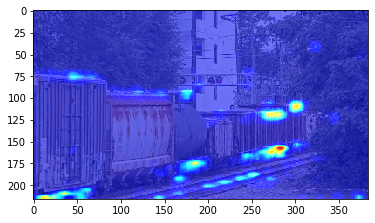

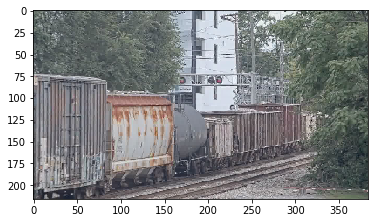

Model said train/variety000082.jpg did not contain a train (0.18928703665733337), but it did:


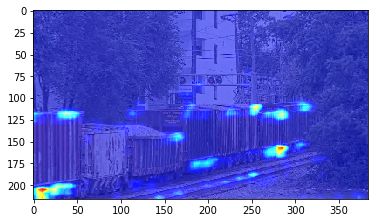

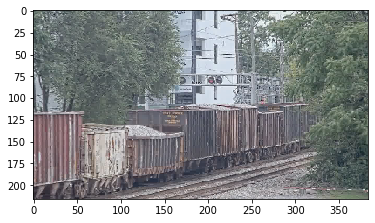

Model said train/variety000083.jpg did not contain a train (0.38518214225769043), but it did:


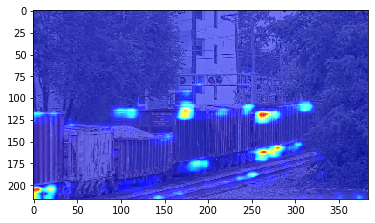

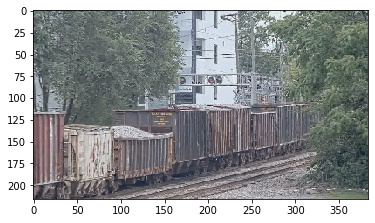

Model said train/variety000085.jpg did not contain a train (0.3880600929260254), but it did:


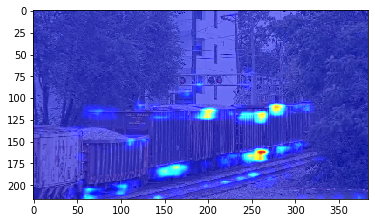

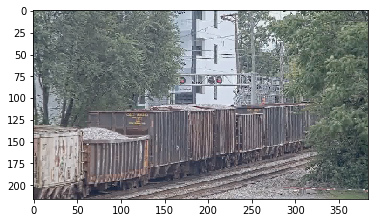

Model said train/variety000093.jpg did not contain a train (0.1313764750957489), but it did:


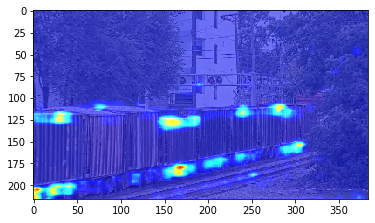

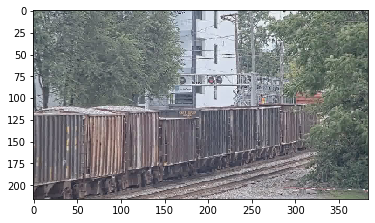

Model said train/variety000094.jpg did not contain a train (0.1471633017063141), but it did:


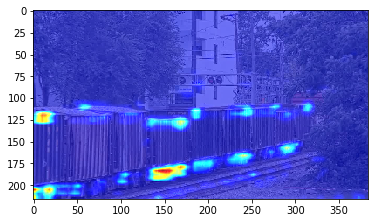

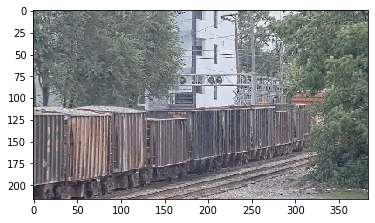

Model said train/variety000124.jpg did not contain a train (0.36664754152297974), but it did:


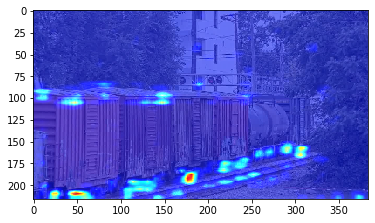

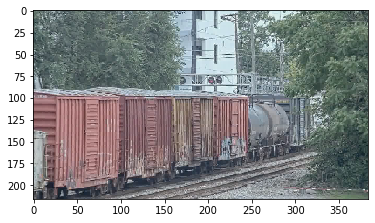

Model said train/variety000125.jpg did not contain a train (0.3805274963378906), but it did:


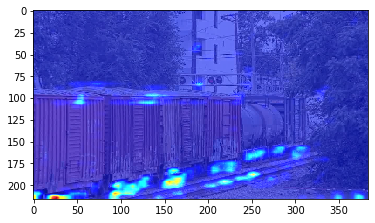

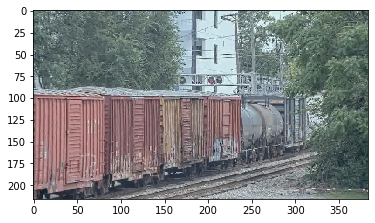

Model said train/variety000126.jpg did not contain a train (0.4251130223274231), but it did:


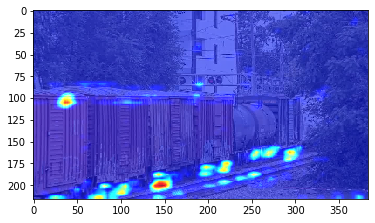

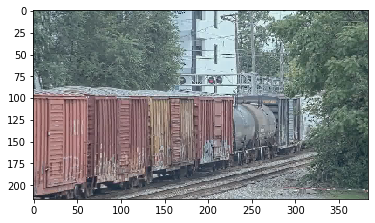

Model said train/variety000144.jpg did not contain a train (0.45315584540367126), but it did:


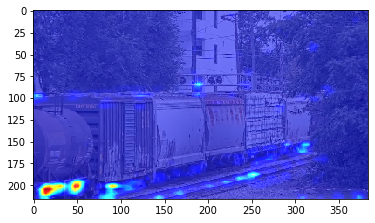

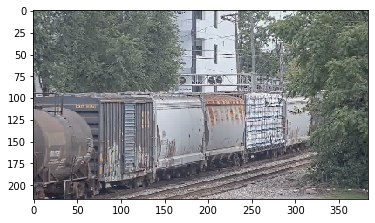

Model said train/variety000146.jpg did not contain a train (0.4227793514728546), but it did:


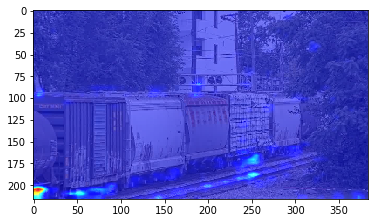

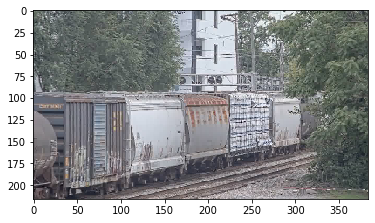

Model said train/variety000157.jpg did not contain a train (0.31114619970321655), but it did:


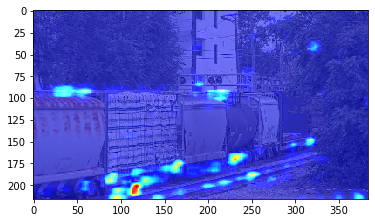

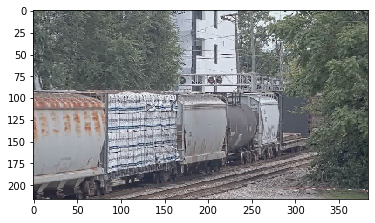

Model said train/variety000176.jpg did not contain a train (0.3658480942249298), but it did:


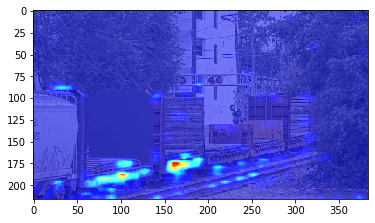

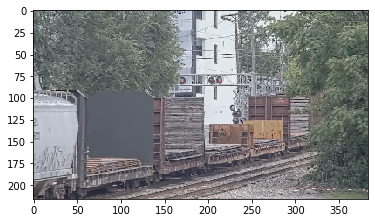

Model said train/variety000177.jpg did not contain a train (0.23666805028915405), but it did:


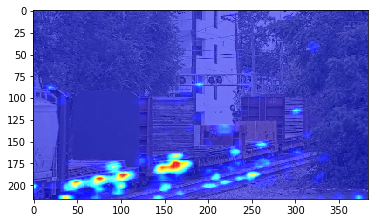

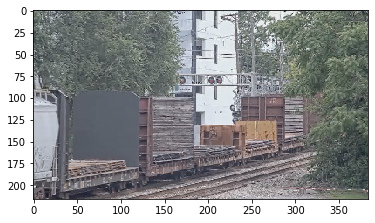

Model said train/variety000178.jpg did not contain a train (0.3668701946735382), but it did:


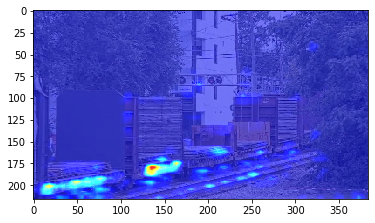

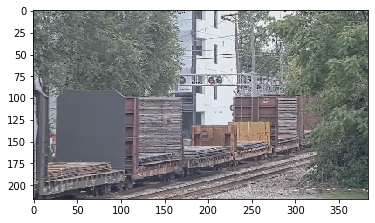

Model said train/variety000183.jpg did not contain a train (0.2548140287399292), but it did:


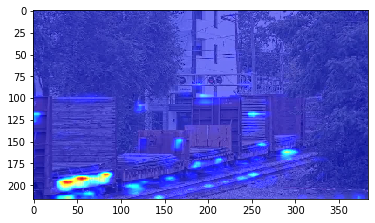

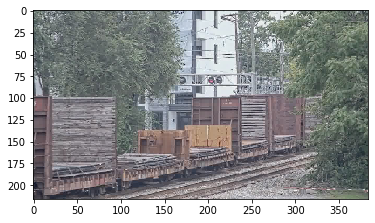

Model said train/variety000184.jpg did not contain a train (0.2317894697189331), but it did:


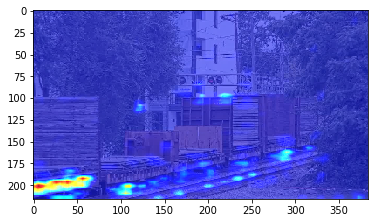

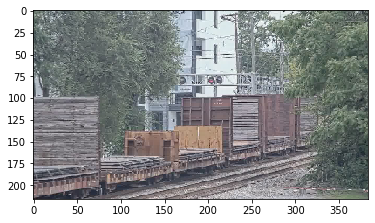

Model said train/variety000186.jpg did not contain a train (0.3371471166610718), but it did:


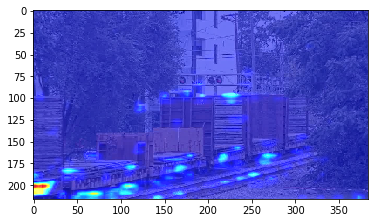

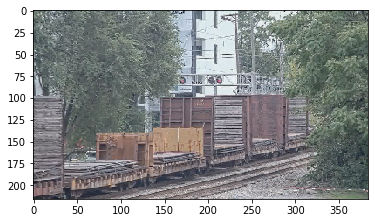

Model said train/variety000188.jpg did not contain a train (0.49142125248908997), but it did:


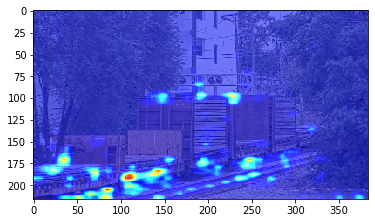

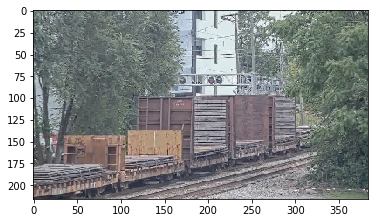

Model said train/variety000199.jpg did not contain a train (0.42538031935691833), but it did:


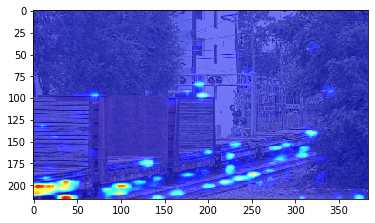

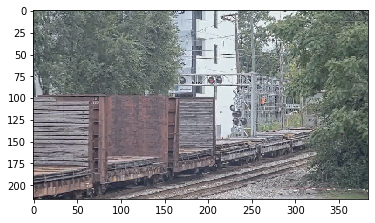

Model said train/variety000206.jpg did not contain a train (0.31997817754745483), but it did:


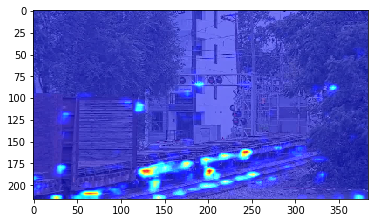

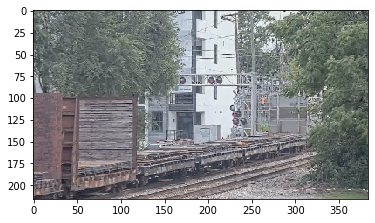

Model said train/variety000207.jpg did not contain a train (0.45834261178970337), but it did:


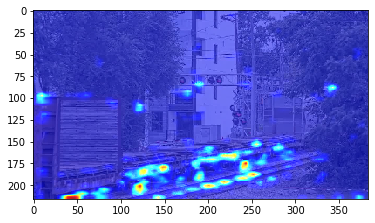

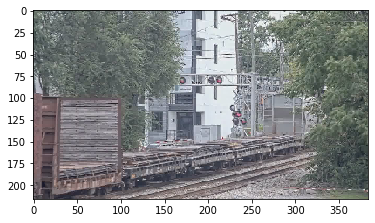

Model said train/variety000210.jpg did not contain a train (0.4918023943901062), but it did:


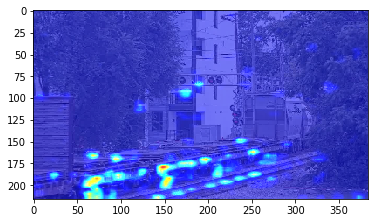

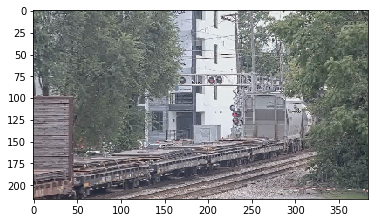

Model said train/variety000211.jpg did not contain a train (0.4951029419898987), but it did:


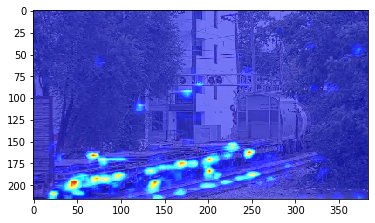

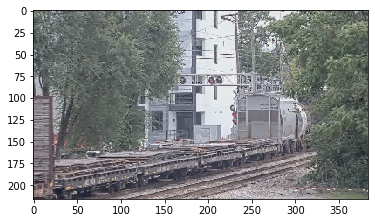

Model said train/variety000212.jpg did not contain a train (0.18591943383216858), but it did:


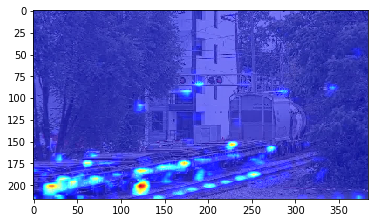

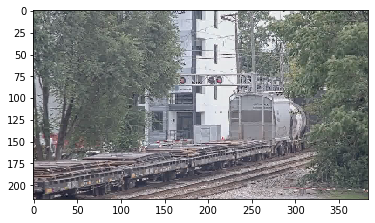

Model said train/variety000213.jpg did not contain a train (0.31214335560798645), but it did:


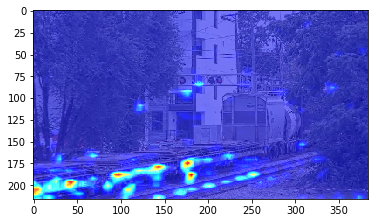

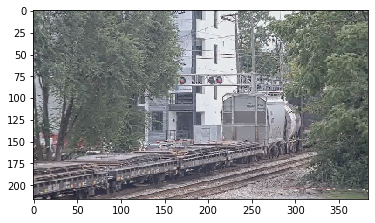

Model said train/variety000214.jpg did not contain a train (0.2560807168483734), but it did:


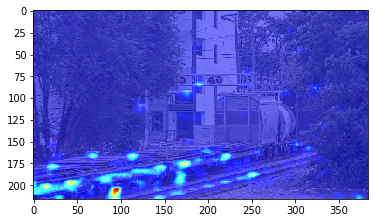

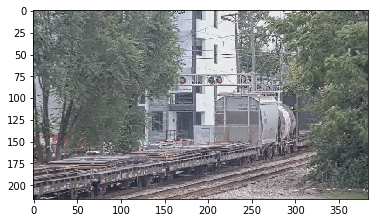

Model said train/variety000215.jpg did not contain a train (0.4894571900367737), but it did:


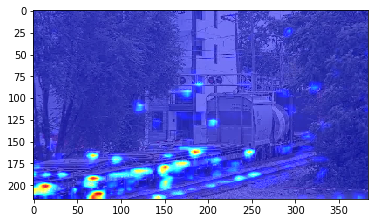

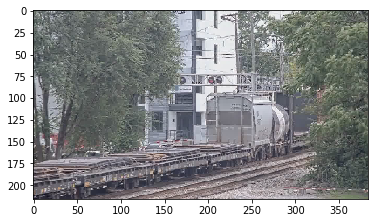

Model said train/variety000216.jpg did not contain a train (0.2357475459575653), but it did:


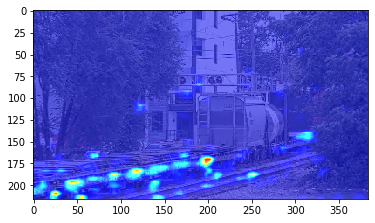

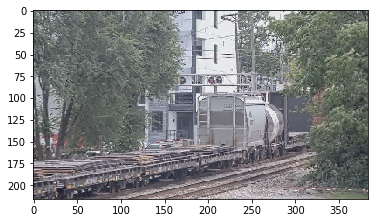

Model said train/variety000217.jpg did not contain a train (0.36115747690200806), but it did:


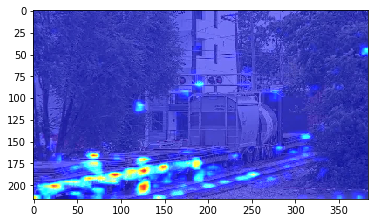

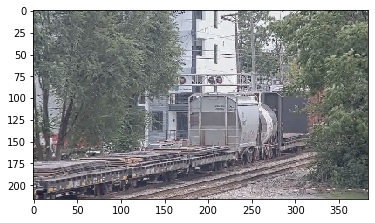

Model said train/variety000218.jpg did not contain a train (0.11437460780143738), but it did:


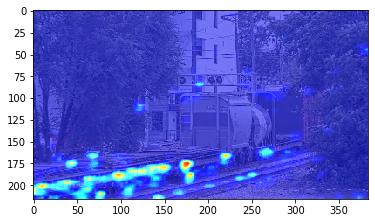

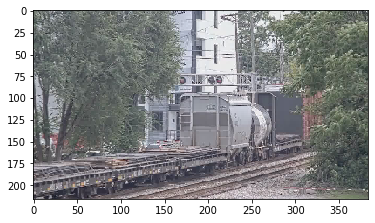

Model said train/variety000219.jpg did not contain a train (0.12581145763397217), but it did:


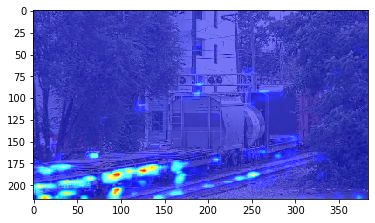

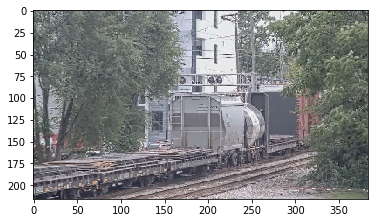

Model said train/variety000220.jpg did not contain a train (0.26337113976478577), but it did:


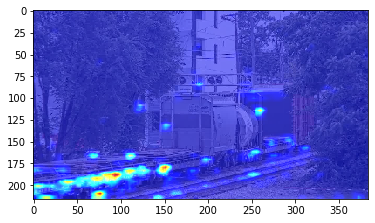

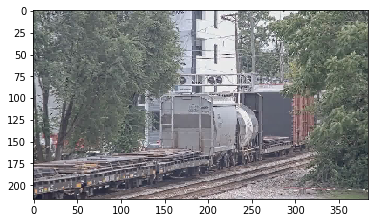

Model said train/variety000221.jpg did not contain a train (0.1364629864692688), but it did:


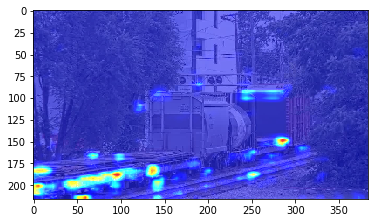

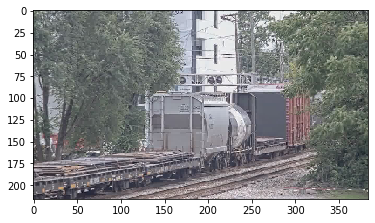

Model said train/variety000222.jpg did not contain a train (0.10009020566940308), but it did:


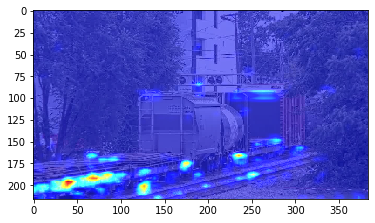

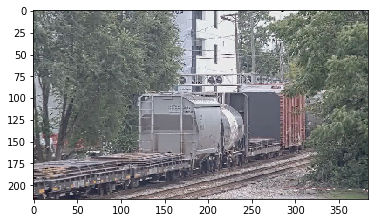

Model said train/variety000223.jpg did not contain a train (0.16480815410614014), but it did:


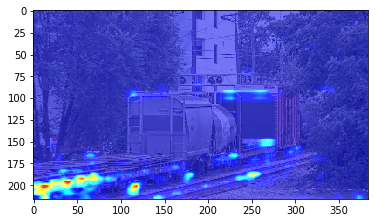

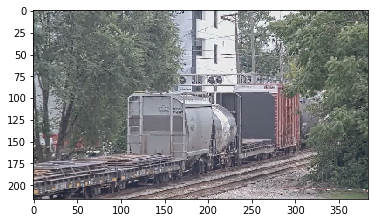

Model said train/variety000224.jpg did not contain a train (0.1099672019481659), but it did:


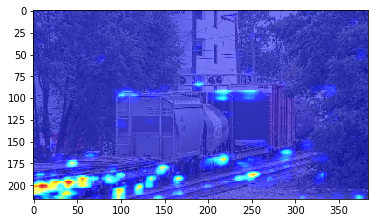

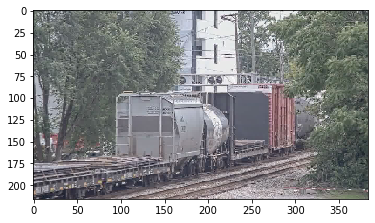

Model said train/variety000226.jpg did not contain a train (0.1552594006061554), but it did:


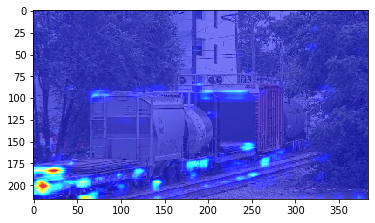

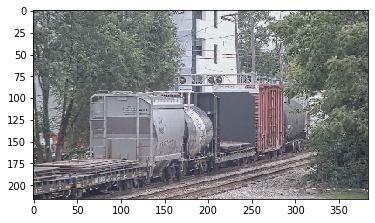

Model said train/variety000237.jpg did not contain a train (0.3715634346008301), but it did:


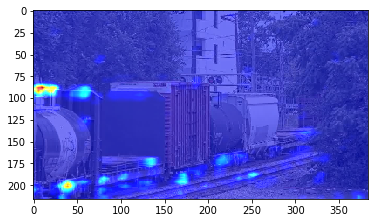

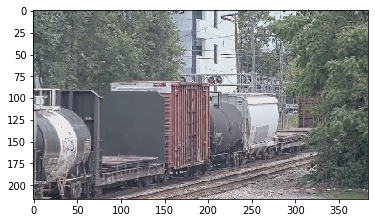

Model said train/variety000238.jpg did not contain a train (0.3243728280067444), but it did:


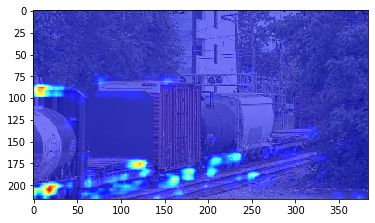

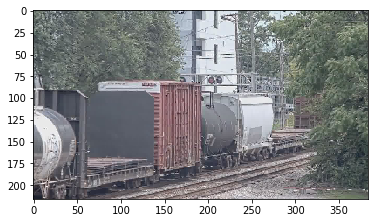

Model said train/variety000239.jpg did not contain a train (0.42405205965042114), but it did:


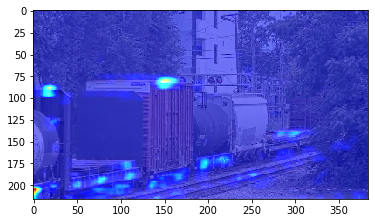

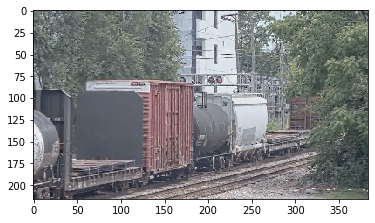

Model said train/variety000242.jpg did not contain a train (0.19202068448066711), but it did:


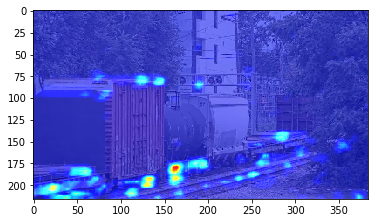

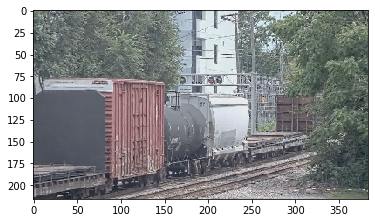

Model said train/variety000243.jpg did not contain a train (0.10797625780105591), but it did:


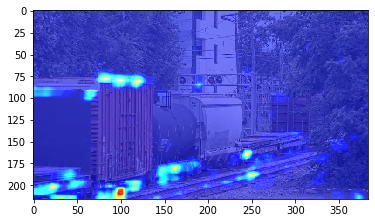

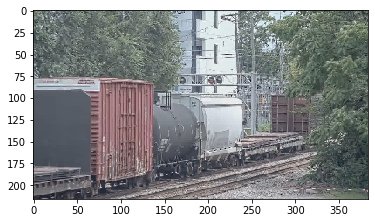

Model said train/variety000244.jpg did not contain a train (0.2243538796901703), but it did:


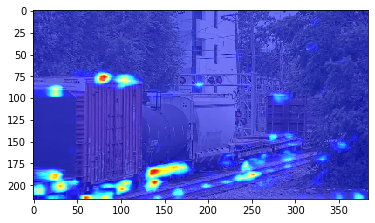

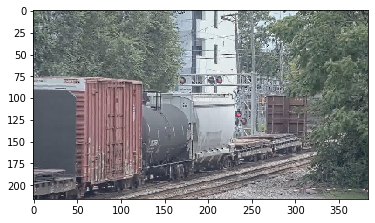

Model said train/variety000245.jpg did not contain a train (0.24118572473526), but it did:


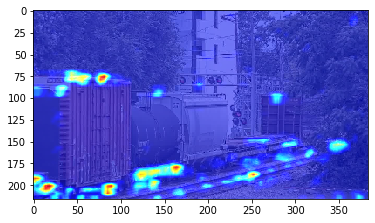

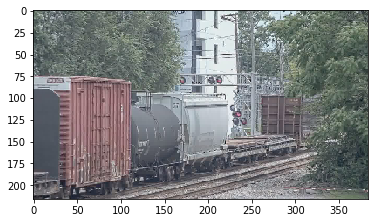

Model said train/variety000246.jpg did not contain a train (0.24900293350219727), but it did:


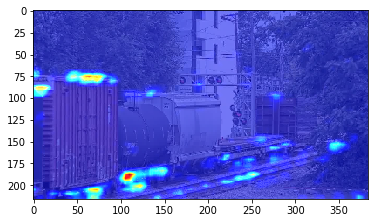

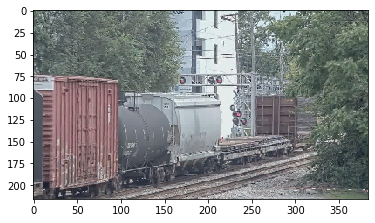

Model said train/variety000260.jpg did not contain a train (0.25995486974716187), but it did:


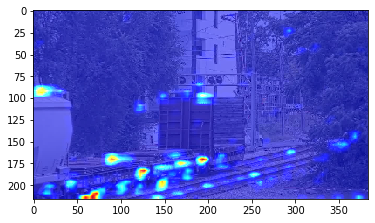

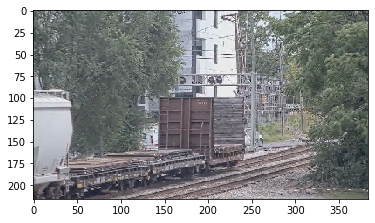

Model said train/variety000261.jpg did not contain a train (0.2216281294822693), but it did:


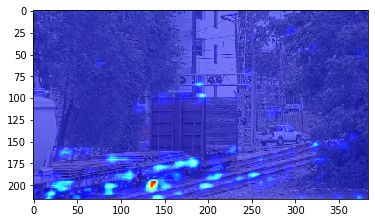

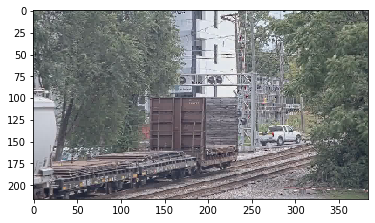

Model said train/variety000262.jpg did not contain a train (0.27651914954185486), but it did:


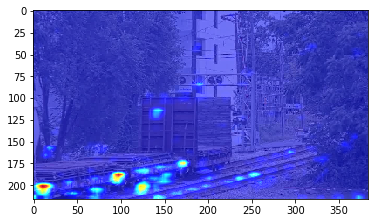

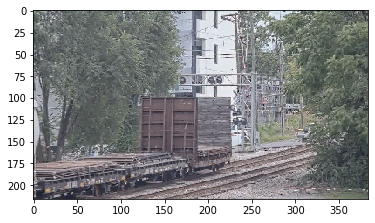

Misclassified 100 images.


In [19]:
# Round to nearest class label (1 "train" or 0 "no_train")
pred_class_idxs = np.around(y_pred)
filenames = validation_generator.filenames
miss_count = 0
for i in range(num_validation_samples):
    if int(pred_class_idxs[i]) != y_true[i]:
        miss_count += 1
        if y_true[i] == class_idx_dict['no_train']:
            print('Model said {} contained a train ({}), but it didn\'t:'.format(filenames[i], y_pred[i]))
        else:
            print('Model said {} did not contain a train ({}), but it did:'.format(filenames[i], y_pred[i]))
        batch_number = i // batch_size
        img_number = i % batch_size
        img = validation_generator[batch_number][0][img_number]
        img_heatmap = create_grad_cam_heatmap('data/validation/' + filenames[i])
        plt.imshow(img_heatmap)
        plt.show()
        plt.imshow(img)
        plt.show()

print('Misclassified {} images.'.format(miss_count))


In [20]:
cm = confusion_matrix(y_true, pred_class_idxs)
print('Confusion Matrix:')
print(cm)
true_negatives = cm[0][0]
false_negatives = cm[1][0]
true_positives = cm[1][1]
false_positives = cm[0][1]
print('True negatives: {}'.format(true_negatives))
print('False negatives: {}'.format(false_negatives))
print('True positives: {}'.format(true_positives))
print('False positives: {}'.format(false_positives))

Confusion Matrix:
[[145  45]
 [ 55 504]]
True negatives: 145
False negatives: 55
True positives: 504
False positives: 45
